In [40]:
import pandas as pd
import numpy as np
import re
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

**First look at the data**

In [2]:
data = pd.read_csv('../input/kaggle-survey-2022/kaggle_survey_2022_responses.csv', low_memory=False)

In [3]:
data.shape

(23998, 296)

In [4]:
data.head(2)

,Duration (in seconds),Q2,Q3,Q4,Q5,Q6_1,Q6_2,Q6_3,Q6_4,Q6_5,...,Q44_3,Q44_4,Q44_5,Q44_6,Q44_7,Q44_8,Q44_9,Q44_10,Q44_11,Q44_12
0,Duration (in seconds),What is your age (# years)?,What is your gender? - Selected Choice,In which country do you currently reside?,"Are you currently a student? (high school, uni...",On which platforms have you begun or completed...,On which platforms have you begun or completed...,On which platforms have you begun or completed...,On which platforms have you begun or completed...,On which platforms have you begun or completed...,...,Who/what are your favorite media sources that ...,Who/what are your favorite media sources that ...,Who/what are your favorite media sources that ...,Who/what are your favorite media sources that ...,Who/what are your favorite media sources that ...,Who/what are your favorite media sources that ...,Who/what are your favorite media sources that ...,Who/what are your favorite media sources that ...,Who/what are your favorite media sources that ...,Who/what are your favorite media sources that ...
1,121,30-34,Man,India,No,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


There are totally 44 questions, according to which our column should be 44, but here we can see there's 296, this is because, few questions have multiple choices and each choices are marked as seperate columns and this adds up to the total 296 columns, and the very first row corresponds to the questions.

**Data Preparation**

Group each question and it's answer together and get the count of each answer.

In [5]:
# Drop the duration column because it's not really useful here.

data = pd.DataFrame(data.drop(labels = ['Duration (in seconds)'], axis = 1))

In [6]:
all_questions = data.iloc[0]

In [7]:
data = data.drop(index=0)

In [8]:
all_questions_groups = {}
multiple_questions_groups = {}

for col in all_questions.index:   
    group_col = re.match(r'^[Q][0-9]+[_]', col)    
    if not group_col:
        all_questions_groups[col] = None       
        continue   
    group_col = group_col[0][:-1]
        
    sub_group = re.match(r'^[Q][0-9]+[_][0-9]+', col)[0]
    
    if group_col in all_questions_groups:
        all_questions_groups[group_col].append(sub_group)
        multiple_questions_groups[group_col].append(sub_group)
    else:
        all_questions_groups[group_col] = [sub_group]
        multiple_questions_groups[group_col] = [sub_group]

In [9]:
null_count_dict = {}

for key in data.columns[1:]:    
    x = [q for q in data.columns[1:] if q.split('_')[0] == key.split('_')[0]]
    if len(x) == 1:       
        null_count_dict[x[0]] = data[x[0]].isnull().sum()
    else:        
        question = key.split('_')[0]
        null_count_dict[question] = data[x].isnull().values.all(axis=1).sum()
        
null_count_dict = dict(sorted(null_count_dict.items(), key=lambda item: item[1], reverse=True))

questions, missing_nums = [], []
for key, value in null_count_dict.items():
    questions.append(key)
    missing_nums.append(value)

Printing all the questions and respective count of it's choices.

In [10]:
def print_question(question, question_id):
    print() 
    print(str(question_id) + ' \033[1m' + str(question) + '\033[0m')    
    
def print_question_summary(question, question_id):    
    print()
    print('Ammount of participants that didn\'t answer this question - {}'.format(null_count_dict.get(question_id)))
    print('-'*66)
    print() 
    
def print_Multiple_choice_question_answers(df, question, question_ids):   
    print('\033[94m' + 'Multiple choice question' + '\033[0m')
    print()   
    choices = pd.Series(dtype='float64')       
    for col in question_ids:          
        counts = df[col].value_counts()        
        counts_name = str(counts.index[0].strip())
        counts_number = int(counts.iloc[0])
        choices[counts_name] = counts_number    
    choices.sort_values(ascending=False, inplace=True)    
    print(choices.to_string())    
        
def print_Single_choice_question_answers(df, question, question_id):    
    print('\033[92m' + 'Single choice question' + '\033[0m')
    print()
    choices_col = df[[question_id]].iloc[1:]
    choices = pd.Series(choices_col.value_counts())
    print(choices.to_string(header=False))

In [11]:
def print_questions_info(all_questions_groups):
    for key in all_questions_groups:
        question_id = key
        if all_questions_groups[key]:
            question_ids = all_questions_groups[key]
            question = str(all_questions[key+'_1'])
            question = question.split('?')[0] + '?'        
            print_question(question, question_id)
            print_Multiple_choice_question_answers(data, question, question_ids)
            print_question_summary(question, question_id)
        else:
            question = all_questions[key]
            print_question(question, question_id)
            print_Single_choice_question_answers(data, question, question_id)
            print_question_summary(question, question_id)

In [12]:
print_questions_info(all_questions_groups)


Q2 What is your age (# years)?
Single choice question

18-21    4559
25-29    4472
22-24    4283
30-34    2971
35-39    2353
40-44    1927
45-49    1253
50-54     914
55-59     611
60-69     526
70+       127

Ammount of participants that didn't answer this question - None
------------------------------------------------------------------


Q3 What is your gender? - Selected Choice
Single choice question

Man                        18265
Woman                       5286
Prefer not to say            334
Nonbinary                     78
Prefer to self-describe       33

Ammount of participants that didn't answer this question - 0
------------------------------------------------------------------


Q4 In which country do you currently reside?
Single choice question

India                                                   8791
United States of America                                2920
Other                                                   1430
Brazil                                    

**Initial Insights**

1. The maximum number of kaggle users are between the age 18-21.
2. 76% of kaggle users are men and 22% are women.
3. Kaggle is used over 56 countries.India and USA being at the top. One of the noticeable things is that there are more Asian and Wester countries compared to Middle Eastern Countries.And the amount of people from these countries is also less in number.
4. Student community is pretty active on kaggle, it's 50:50. 
5. Coursera, Kaggle, Udemy are the most commonly used platform.
6. Kaggle is also used by beginners to start their data science journey.
7. Many kagglers have focused on Master's as their highest education.
8. About 20% have publised research papers.
9. Python is the most used language and SQL is the 2nd highest. It also means there are many data analysts in kaggle.
10. Jupyter, VSCode, PyCharm contributes 50% of the over all IDE's.
11. Matplotlib, Seaborn and Plotly are the most used Visualizing Libraries.
12. Around 17% of the people claim that they don't use any ML methods.
13. About 23% of participats reported they have spent money on ML or Cloud Computing.

**EDA of the Survey**

In [13]:
data = pd.read_csv('../input/kaggle-survey-2022/kaggle_survey_2022_responses.csv', low_memory=False)

In [14]:
data.columns = data.iloc[0]
data = data[1:]

In [15]:
data.columns = data.columns.str.replace(' - Selected Choice', '')
data.columns = data.columns.str.replace(r'\(Select all that apply\) -', '')
data.columns = data.columns.str.replace(' (Select all that apply): -', '', regex=False)
data.rename(columns=lambda x: re.sub(' +', ' ', x), inplace=True)
data.columns = data.columns.str.rstrip()

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  


Age Distribution of Kaggle Users

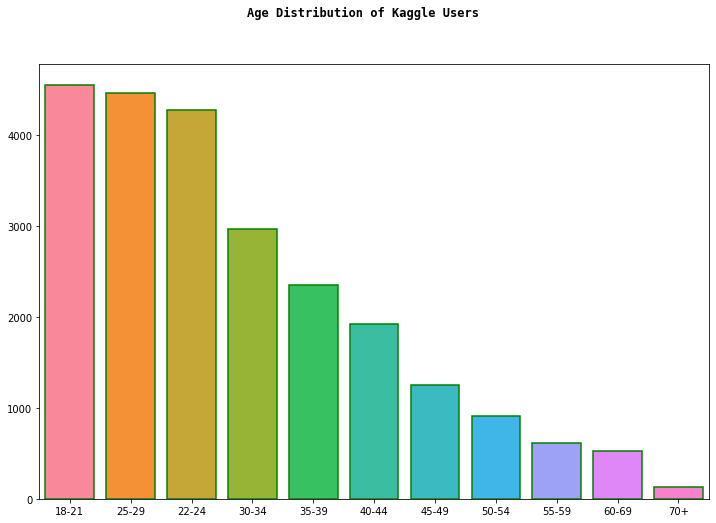

In [16]:
fig, ax = plt.subplots(figsize=(12,8))
sns.barplot(x=data['What is your age (# years)?'].value_counts().index, y=data['What is your age (# years)?'].value_counts().values, ax=ax,
           edgecolor='green', linewidth=1.5, saturation=1.5)


plt.suptitle('Age Distribution of Kaggle Users', fontname = 'monospace', weight='bold')
plt.show()


Age Distribution of Kaggle Users

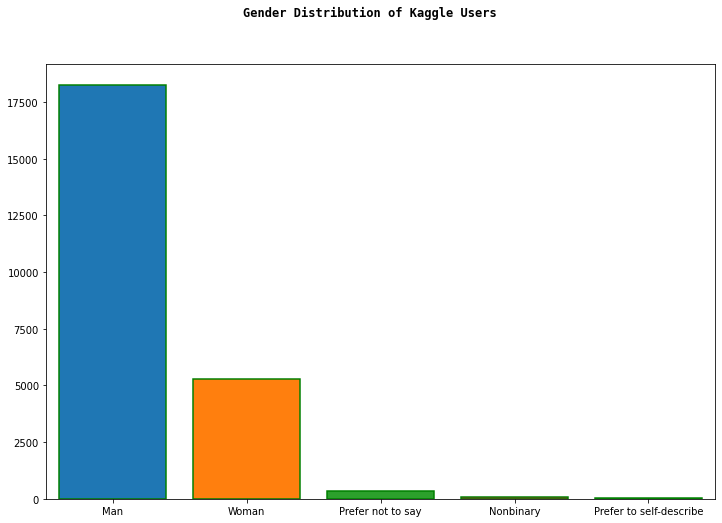

In [17]:
fig, ax = plt.subplots(figsize=(12,8))
sns.barplot(x=data['What is your gender?'].value_counts().index, y=data['What is your gender?'].value_counts().values, ax=ax,
           edgecolor='green', linewidth=1.5, saturation=1.5)


plt.suptitle('Gender Distribution of Kaggle Users', fontname = 'monospace', weight='bold')
plt.show()


Age and Gender Hierarchical distribution

In [18]:
fig = px.sunburst(data_frame=data,
                  path=['What is your gender?', 'What is your age (# years)?'],
                  color='What is your gender?',
                  title='Gender and Age'
                 )
fig.show()

Participats Around the World.

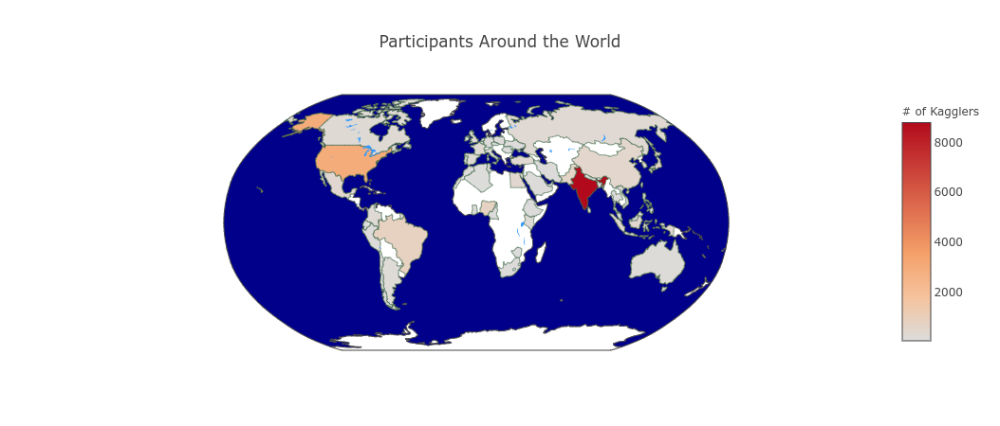

In [19]:
import plotly.offline as py
py.offline.init_notebook_mode()

def plot_in_map(locations,counts,title):
    dic = [ dict(
            type = 'choropleth',
            locations = locations,
            z = counts,
            locationmode = 'country names',
            autocolorscale = True,
            marker = dict(
                line = dict(color = 'rgb(58,100,69)', width = 0.6)),
                colorbar = dict(autotick = True, tickprefix = '', title = '# of Kagglers')
                )
           ]

    layout = dict(
        title = title,
        geo = dict(
            showframe = True,
            showcoastlines = True,
            showocean = True,
            showlakes = True,
            oceancolor = '#00008B',
            projection = dict(
            type = 'robinson'
            ),
        margin = dict(b = 0, t = 0, l = 0, r = 0,pad= 5)
                ),
        autosize = True
        )

    fig = dict(data=dic, layout=layout)
    
    py.iplot(fig, validate=False, filename='world-map')
z = data['In which country do you currently reside?'].value_counts()
plot_in_map(locations=z.index,
            counts=z.values,
            title='Participants Around the World')

Age Distribution by Country

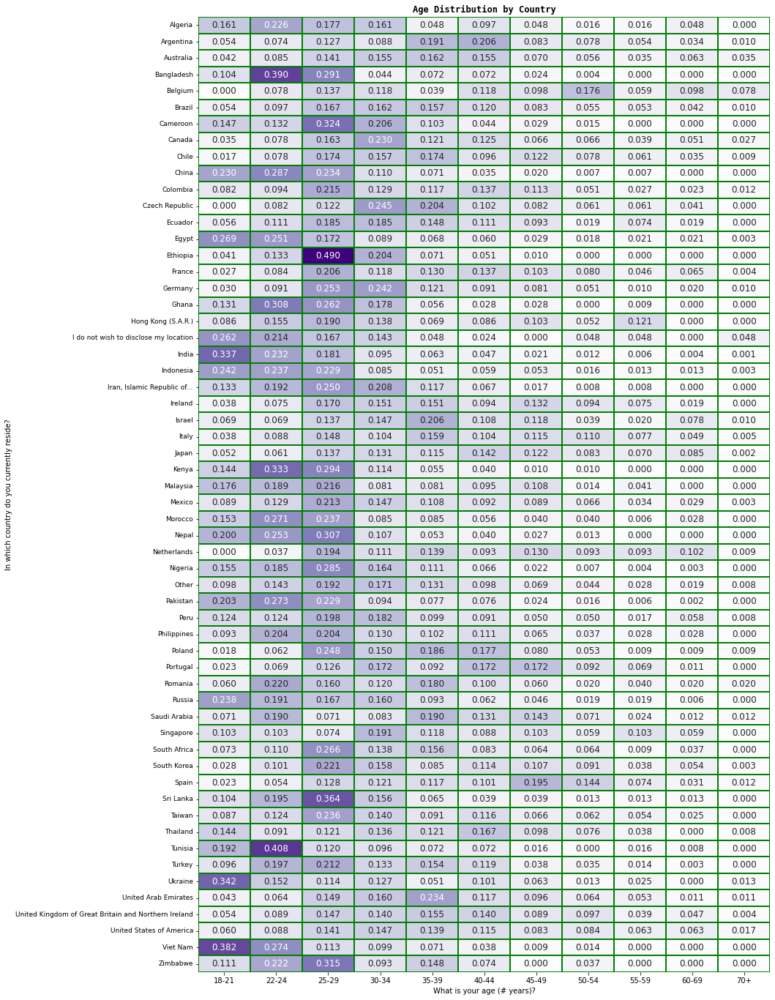

In [20]:
z=data.groupby([ 'In which country do you currently reside?', 'What is your age (# years)?']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 24))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":12}, fmt='.3f', cbar=False)
plt.title('Age Distribution by Country', fontname = 'monospace', weight='bold')
plt.yticks(fontsize=9)
plt.show()
del z

Gender Distribution by Country

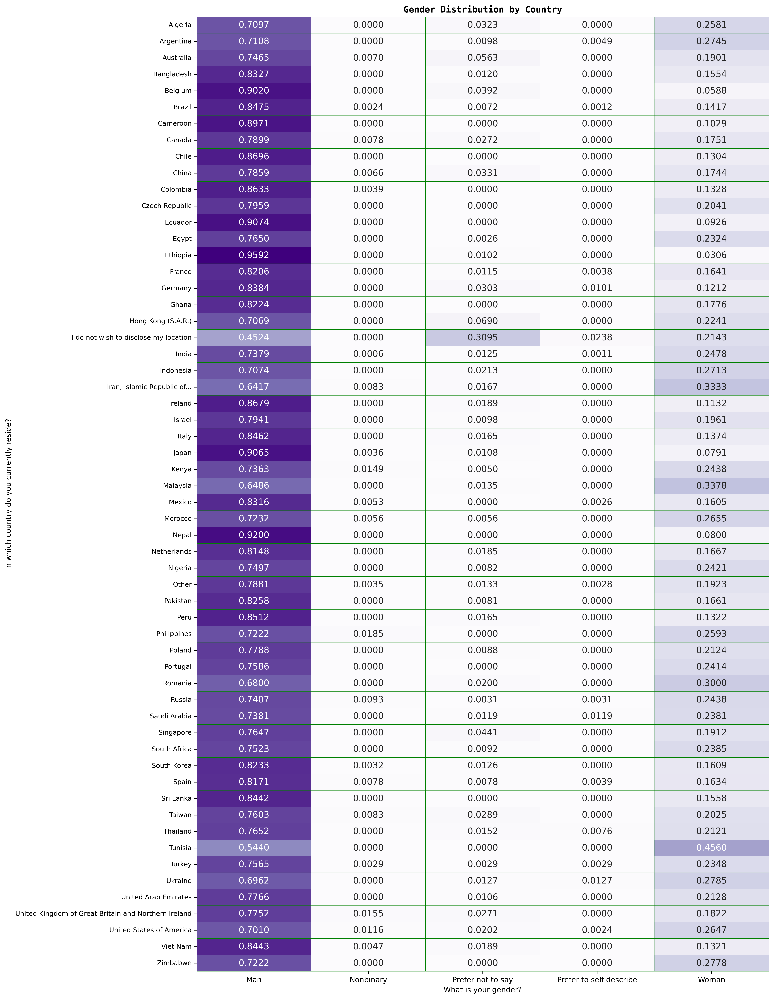

In [32]:
z=data.groupby([ 'In which country do you currently reside?', 'What is your gender?']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 24))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":12}, fmt='.4f', cbar=False)
plt.title('Gender Distribution by Country', fontname = 'monospace', weight='bold')
plt.yticks(fontsize=9)
plt.xticks(fontsize=10)
plt.show()
del z

Education status of kagglers

In [22]:
def count_dist(df, colname=None, fixlabel=False, f_axis=None, fixlabel_n=None, fixlabel_txt=None, max_idx=30, fontsize=12, rotation=45,
              title='X distribution of Kaggle Users', y_label='', shift=-0.005):
    """A function for counting and displaying categorical variables including percentage texts."""
    fig, ax = plt.subplots()
    sns.barplot(y=df[colname].value_counts().index[:max_idx],
                x=df[colname].value_counts().values[:max_idx], edgecolor='green', linewidth=1.5, saturation = 1.5)
    z=df[colname].value_counts().values[:max_idx]
    for n, i in enumerate(df[colname].value_counts().index[:max_idx]):    
        ax.text(df[colname].value_counts().values[:max_idx][n]+shift, 
                n, #Y location
                s=f'{round(z[n]/df.shape[0]*100,1)}%',                 
                va='center', 
                ha='right', 
                color='white', 
                fontsize=fontsize,
                bbox=dict(boxstyle='round',facecolor='green', alpha=0.5))
    if fixlabel:
        if f_axis == 'x':
            labels = [item.get_text() for item in ax.get_xticklabels()]
            labels[fixlabel_n] = fixlabel_txt
            ax.set_xticklabels(labels)
        else:
            labels = [item.get_text() for item in ax.get_yticklabels()]
            labels[fixlabel_n] = fixlabel_txt
            ax.set_yticklabels(labels)            

    plt.title(title, fontname = 'monospace', weight='bold')
    del z
    
    plt.yticks(fontsize=12,rotation=rotation)
    plt.xlabel("# Users", fontname = 'monospace', weight='semibold')
    plt.ylabel(y_label, fontname = 'monospace', weight='semibold')
    plt.show()

In [ ]:
plt.rcParams['figure.figsize'] = (16,12)
plt.rcParams['figure.dpi'] = 400

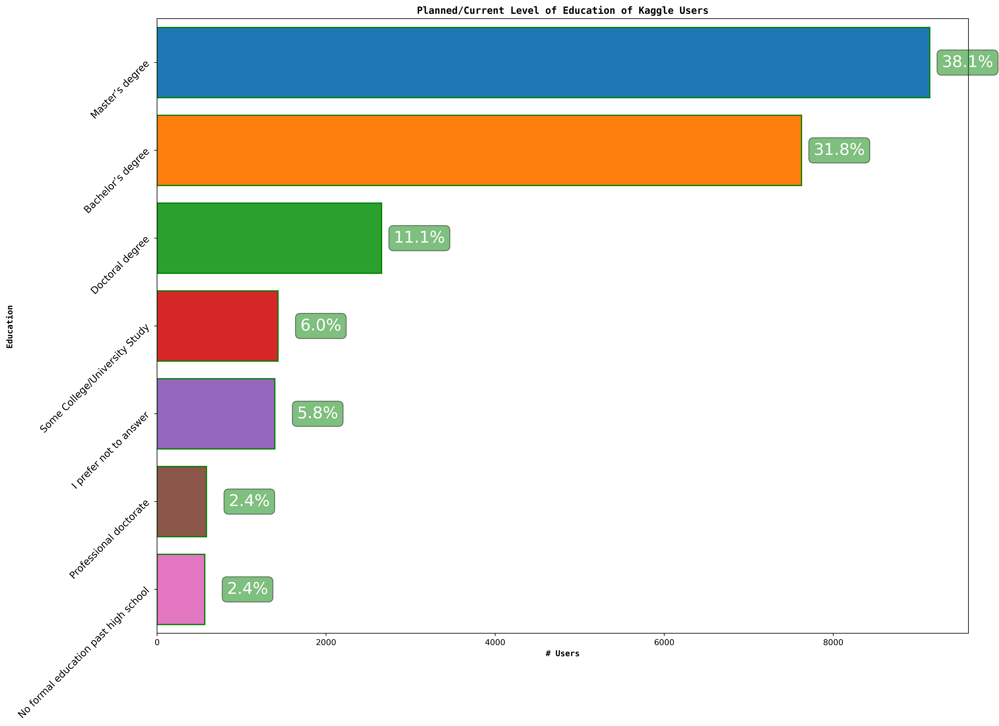

In [30]:
count_dist(df=data, colname='What is the highest level of formal education that you have attained or plan to attain within the next 2 years?', max_idx=14, fontsize=20,
           rotation=45, fixlabel=True, f_axis='y', fixlabel_n=3, fixlabel_txt='Some College/University Study',
           title='Planned/Current Level of Education of Kaggle Users', shift=750, y_label= 'Education')

Current Education distribution by Age

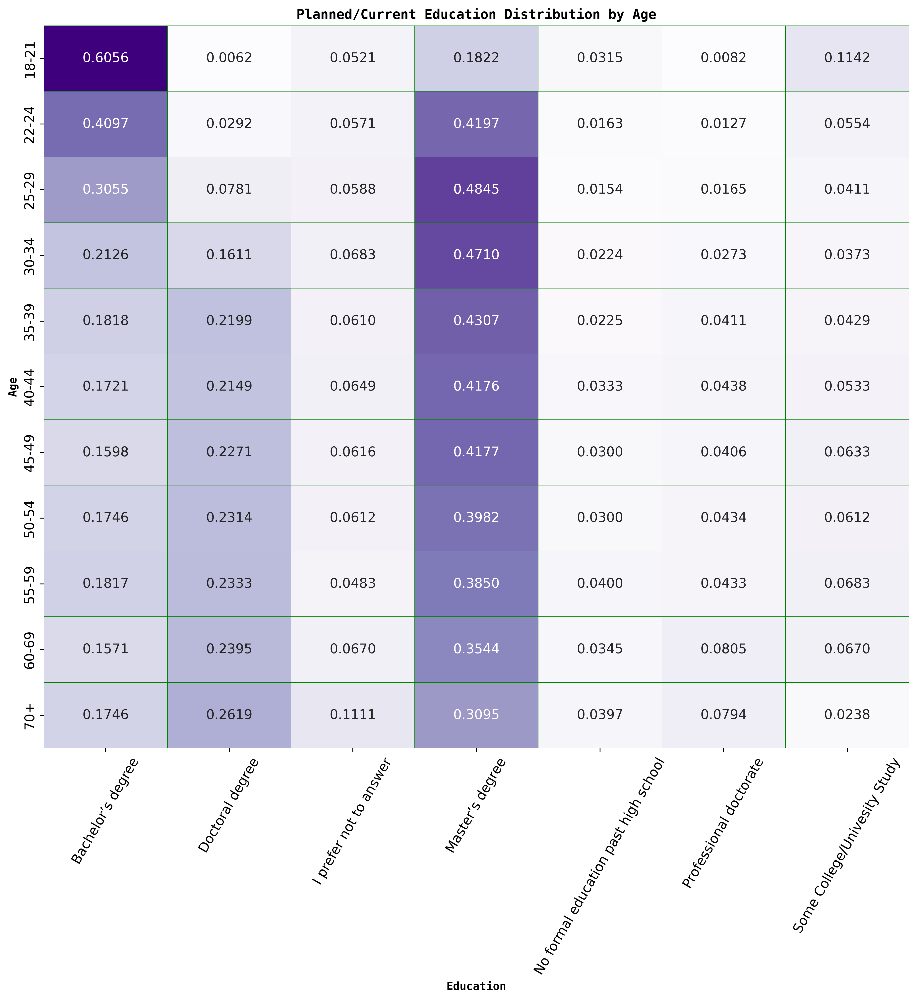

In [31]:
z=data.groupby(['What is your age (# years)?','What is the highest level of formal education that you have attained or plan to attain within the next 2 years?']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 12))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":12}, fmt='.4f', cbar=False)
plt.title('Planned/Current Education Distribution by Age', fontname = 'monospace', weight='bold')
labels = [item.get_text() for item in ax.get_xticklabels()]
labels[-1] = 'Some College/Univesity Study'
ax.set_xticklabels(labels)
plt.xticks(fontsize=12, rotation=60)
plt.yticks(fontsize=12)
plt.xlabel("Education", fontname = 'monospace', weight='semibold')
plt.ylabel("Age", fontname = 'monospace', weight='semibold')
plt.show()
del z

Current Education distribution by Country

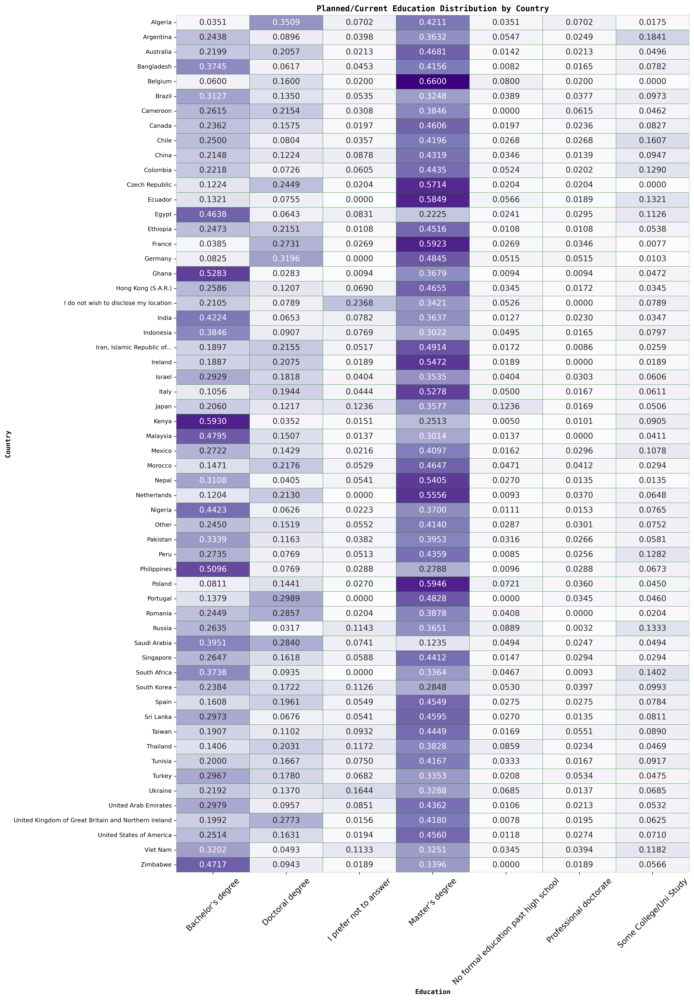

In [33]:
z=data.groupby(['In which country do you currently reside?','What is the highest level of formal education that you have attained or plan to attain within the next 2 years?']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 24))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":12}, fmt='.4f', cbar=False)
plt.title('Planned/Current Education Distribution by Country', fontname = 'monospace', weight='bold')
labels = [item.get_text() for item in ax.get_xticklabels()]
labels[-1] = 'Some College/Uni Study'
ax.set_xticklabels(labels)
plt.xticks(fontsize=12,rotation=45)
plt.yticks(fontsize=9)
plt.xlabel("Education", fontname = 'monospace', weight='semibold')
plt.ylabel("Country", fontname = 'monospace', weight='semibold')
plt.show()
del z

Platforms for data science course

In [42]:
def one_hot_count(df: pd.DataFrame, values:list,text:str, colors=None, shift_text=200, x_freq=2000, title=None, fontsize=12):
    """A function for plotting multi choice questions."""
    
    df2= df.copy()
    for val in values:
        df2[text+val]=df2[text+val].fillna('unk')
        df2[text+val]=df2[text+val].apply(lambda x: x.strip())
        df2[text+val]=df2[text+val].map({val:1, 'unk':0})
    df2.columns = df2.columns.str.replace(text, '', regex=False)
    
    counts = {}
    for col in values:
        counts[col]=df2[col].sum()
    counts = pd.DataFrame.from_dict(counts, orient='index')
    
    fig, ax = plt.subplots(figsize=(18, 14))
    counts = counts.rename(columns={0: 'Count'}).sort_values(by='Count',ascending=False)
    sns.barplot(y=counts.index,
                    x=counts['Count'], palette=colors, edgecolor='green', saturation = 1.5, linewidth = 1.5)
    for n, i in enumerate(counts['Count']):    
        ax.text(counts['Count'][n]+shift_text, 
                n, #Y location
                s=f'{round(counts.Count[n]/len(df2)*100,1)}%', 
                va='center', 
                ha='right', 
                color='white', 
                fontsize=fontsize,
                bbox=dict(boxstyle='round', alpha=0.5))
    plt.xticks(np.arange(x_freq, len(df2)+1, x_freq))
    plt.title(title, fontname = 'monospace', weight='bold')
    plt.show()
    return df2

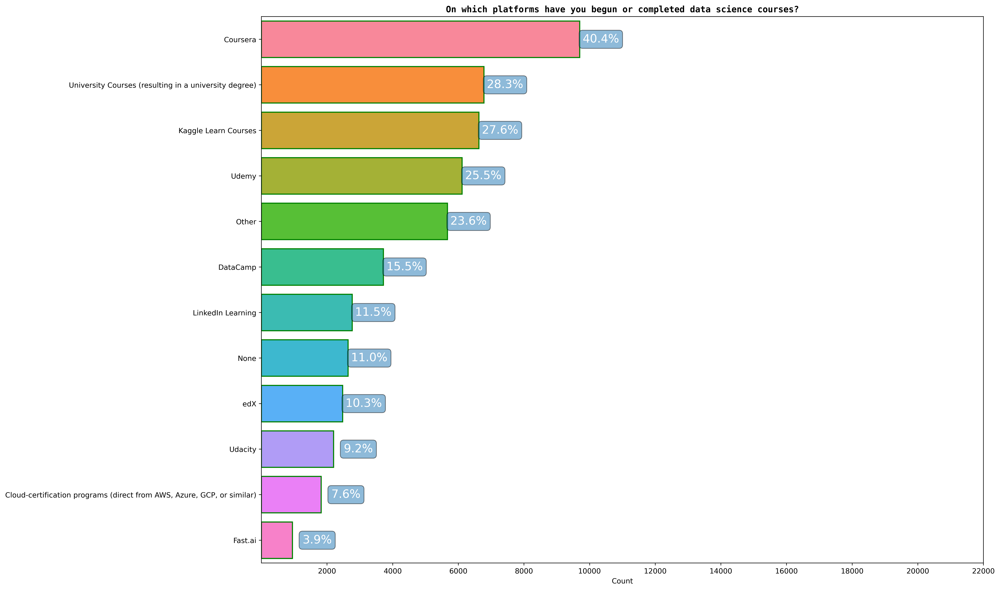

In [43]:
course_cols = [col.split('?')[-1].strip() for col in data.columns if "data science courses" in col]
crs=one_hot_count(df=data, values=course_cols, text="On which platforms have you begun or completed data science courses? ", shift_text=1200, x_freq=2000,
                 title="On which platforms have you begun or completed data science courses?", fontsize=16)

Role Distribution of kaggle users

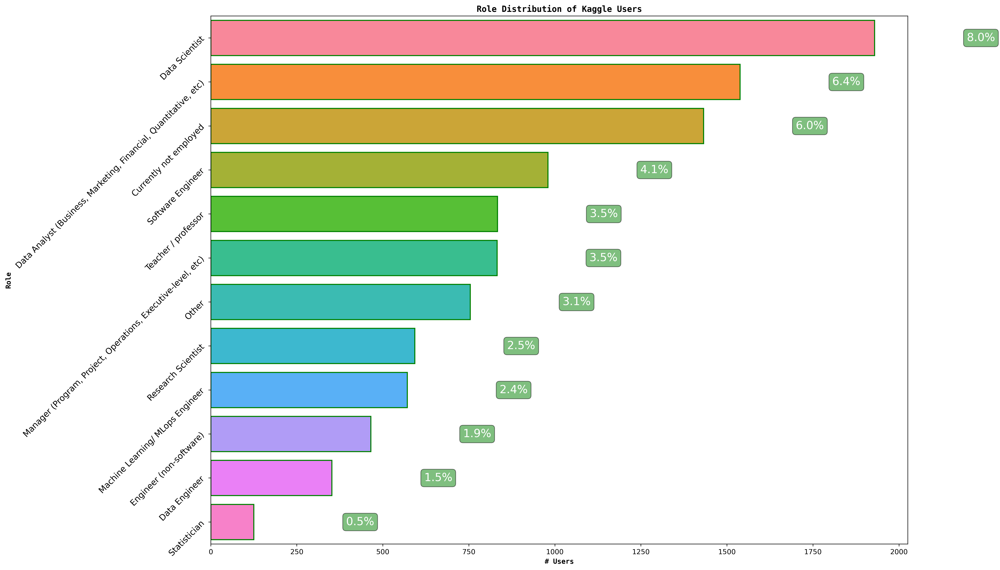

In [48]:
count_dist(df=data, colname='Select the title most similar to your current role (or most recent title if retired):',
           max_idx=12, fontsize=16, rotation=45,
           title='Role Distribution of Kaggle Users', shift=350, y_label = 'Role'
          )

Role distribution by Country

In [49]:
z=data.groupby(['In which country do you currently reside?',
              'Select the title most similar to your current role (or most recent title if retired):']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 24))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":10}, fmt='.4f', cbar=False)
plt.title('Role Distribution by Country', fontname = 'monospace', weight='bold')
plt.xticks(fontsize=12,rotation=90)
plt.yticks(fontsize=10)
plt.xlabel("Role", fontname = 'monospace', weight='semibold')
plt.ylabel("Country", fontname = 'monospace', weight='semibold')
plt.show()
del z

Education distribution by Role

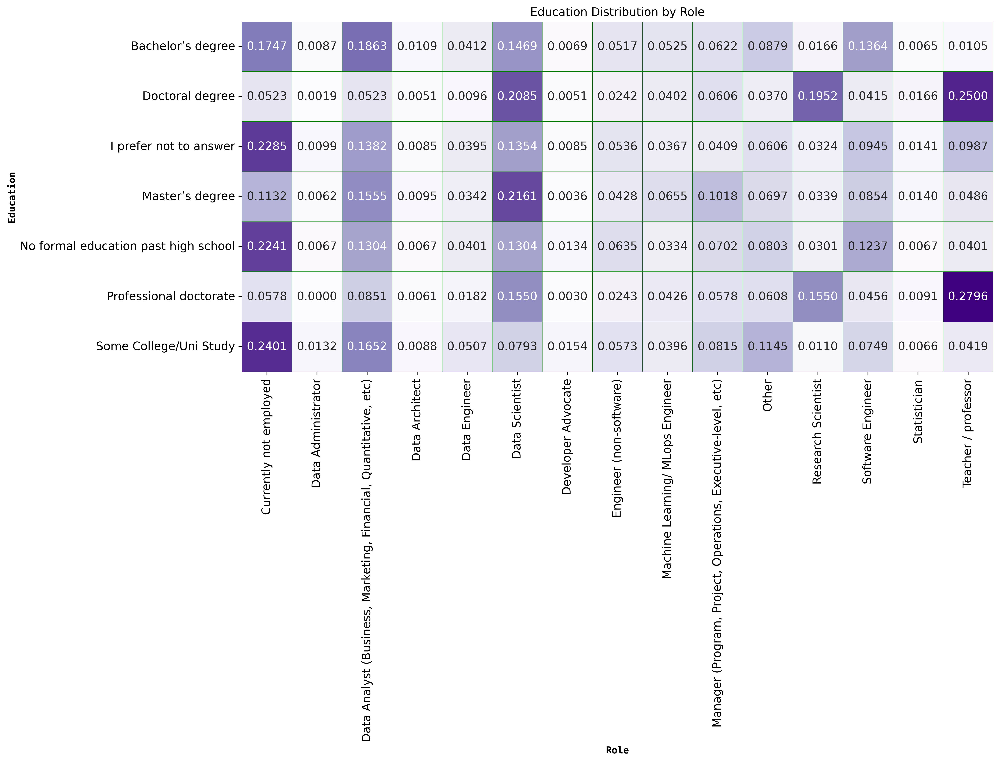

In [51]:
z=data.groupby(['What is the highest level of formal education that you have attained or plan to attain within the next 2 years?',
              'Select the title most similar to your current role (or most recent title if retired):']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 10))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, square=True, cbar=False, linecolor='green', annot_kws={"fontsize":12}, fmt='.4f')
plt.title('Education Distribution by Role')
labels = [item.get_text() for item in ax.get_yticklabels()]
labels[-1] = 'Some College/Uni Study'
ax.set_yticklabels(labels)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlabel('Role', fontname = 'monospace', weight='semibold')
plt.ylabel('Education', fontname = 'monospace', weight='semibold')
plt.show()
del z

Percentage of Title Owners who attended online courses.

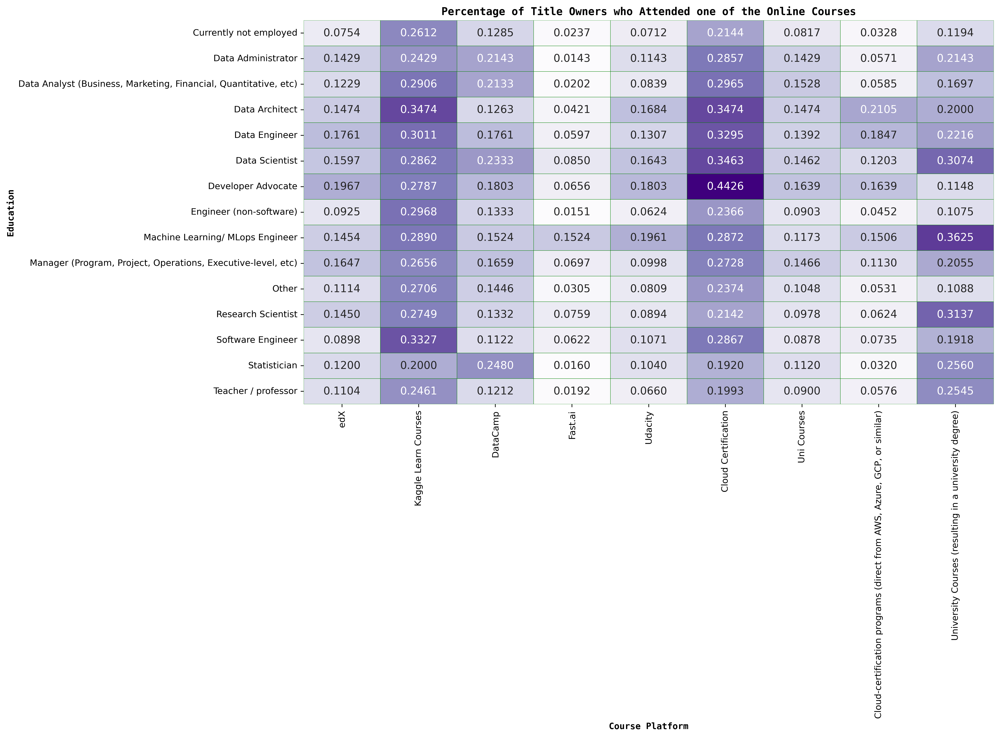

In [52]:
fig, ax = plt.subplots(figsize=(14, 8))
sns.heatmap(crs.groupby('Select the title most similar to your current role (or most recent title if retired):').mean().iloc[:,1:-2],
            xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":12}, fmt='.4f', cbar=False)
plt.title('Percentage of Title Owners who Attended one of the Online Courses', fontname = 'monospace', weight='bold')
plt.ylabel('Education', fontname = 'monospace', weight='semibold')
plt.xlabel('Course Platform', fontname = 'monospace', weight='semibold')
labels = [item.get_text() for item in ax.get_xticklabels()]
labels[-3] = 'Uni Courses'
labels[-4] = 'Cloud Certification'
ax.set_xticklabels(labels)
plt.show()

Years of Programming experience.

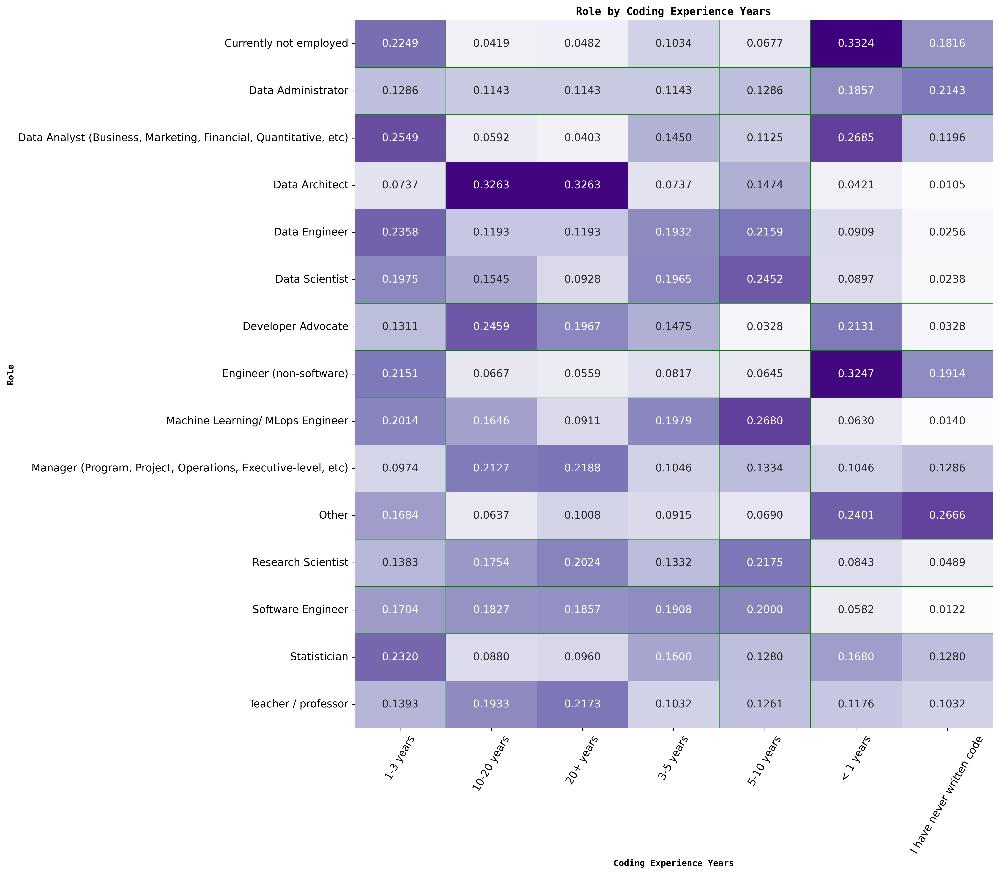

In [53]:
z=data.groupby(['Select the title most similar to your current role (or most recent title if retired):',
             'For how many years have you been writing code and/or programming?']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(16, 14))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":12}, fmt='.4f', cbar=False)
plt.title('Role by Coding Experience Years', fontname = 'monospace', weight='bold')
plt.xticks(fontsize=12,rotation=60)
plt.yticks(fontsize=12)
plt.xlabel('Coding Experience Years', fontname = 'monospace', weight='semibold')
plt.ylabel('Role', fontname = 'monospace', weight='semibold')
plt.tight_layout()
del z

Role and Language Usage

In [57]:
languages = ['C', 'C++', 'Java', 'Javascript', 'Julia', 'Bash','Python', 'R', 'SQL','MATLAB', 'None', 'Other']

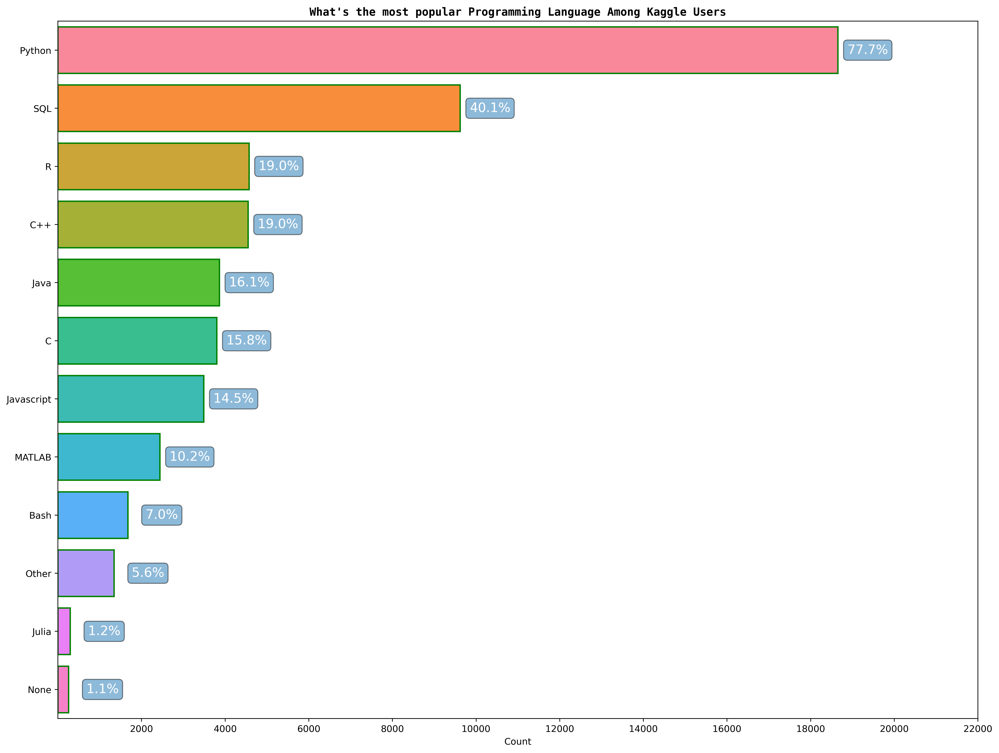

In [59]:
df2=one_hot_count(df=data, values=languages, text='What programming languages do you use on a regular basis? ', shift_text=1200, x_freq=2000,
                 title="What's the most popular Programming Language Among Kaggle Users", fontsize=14)

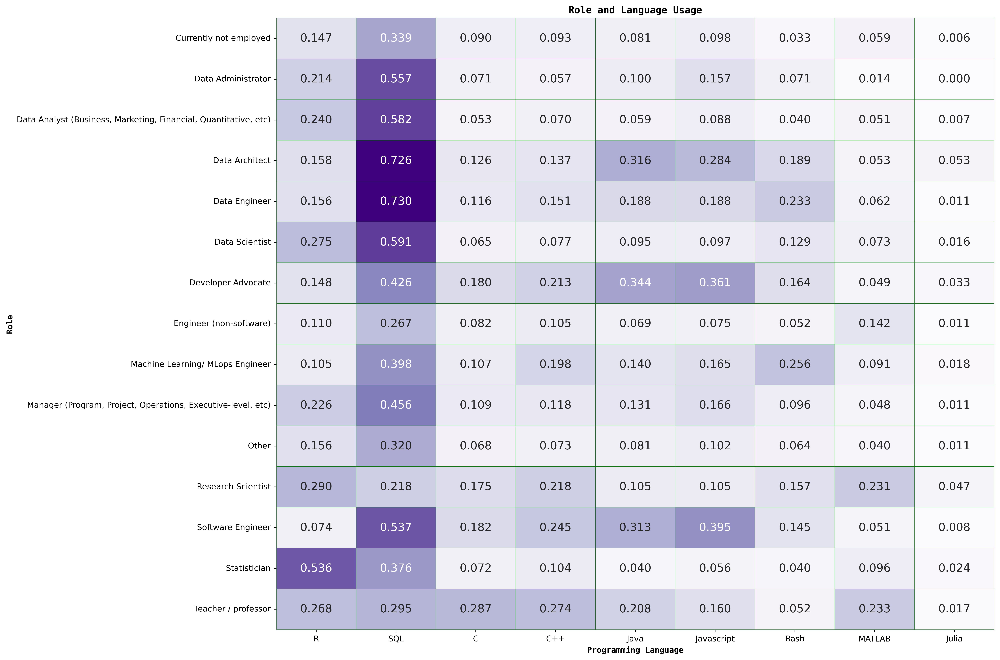

In [60]:
fig, ax = plt.subplots(figsize=(16, 14))
sns.heatmap(df2.groupby('Select the title most similar to your current role (or most recent title if retired):').mean().iloc[:,1:-2],
            xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":14}, fmt='.3f', cbar=False)
plt.title('Role and Language Usage', fontname = 'monospace', weight='bold')
plt.ylabel('Role', fontname = 'monospace', weight='semibold')
plt.xlabel('Programming Language', fontname = 'monospace', weight='semibold')
plt.show()

Education and Language Usage

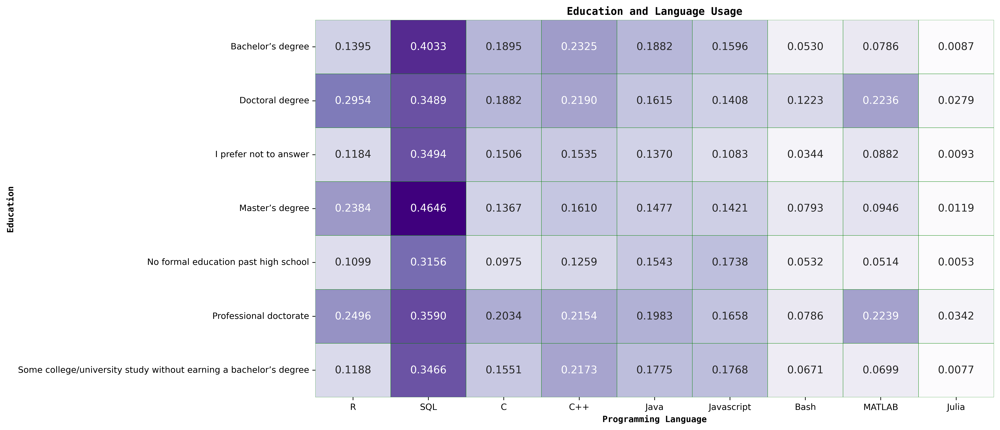

In [61]:
fig, ax = plt.subplots(figsize=(14, 8))
sns.heatmap(df2.groupby('What is the highest level of formal education that you have attained or plan to attain within the next 2 years?').mean().iloc[:,1:-2],
            xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":12}, fmt='.4f', cbar=False)
plt.title('Education and Language Usage', fontname = 'monospace', weight='bold')
plt.ylabel('Education', fontname = 'monospace', weight='semibold')
plt.xlabel('Programming Language', fontname = 'monospace', weight='semibold')
plt.show()

Most used IDE's

In [66]:
ide_cols = [col.split('?')[-1].strip() for col in data.columns if "IDE's" in col]

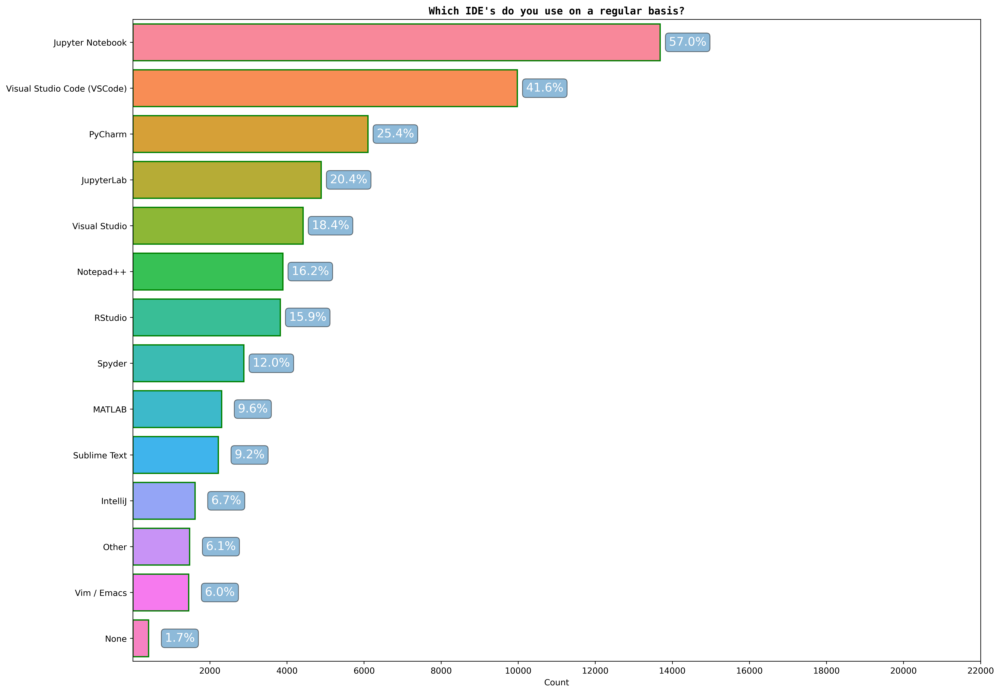

In [67]:
df3=one_hot_count(df=data, values=ide_cols, text="Which of the following integrated development environments (IDE's) do you use on a regular basis? ", shift_text=1200, x_freq=2000,
                 title="Which IDE's do you use on a regular basis?", fontsize=14)

IDE and Language Usage

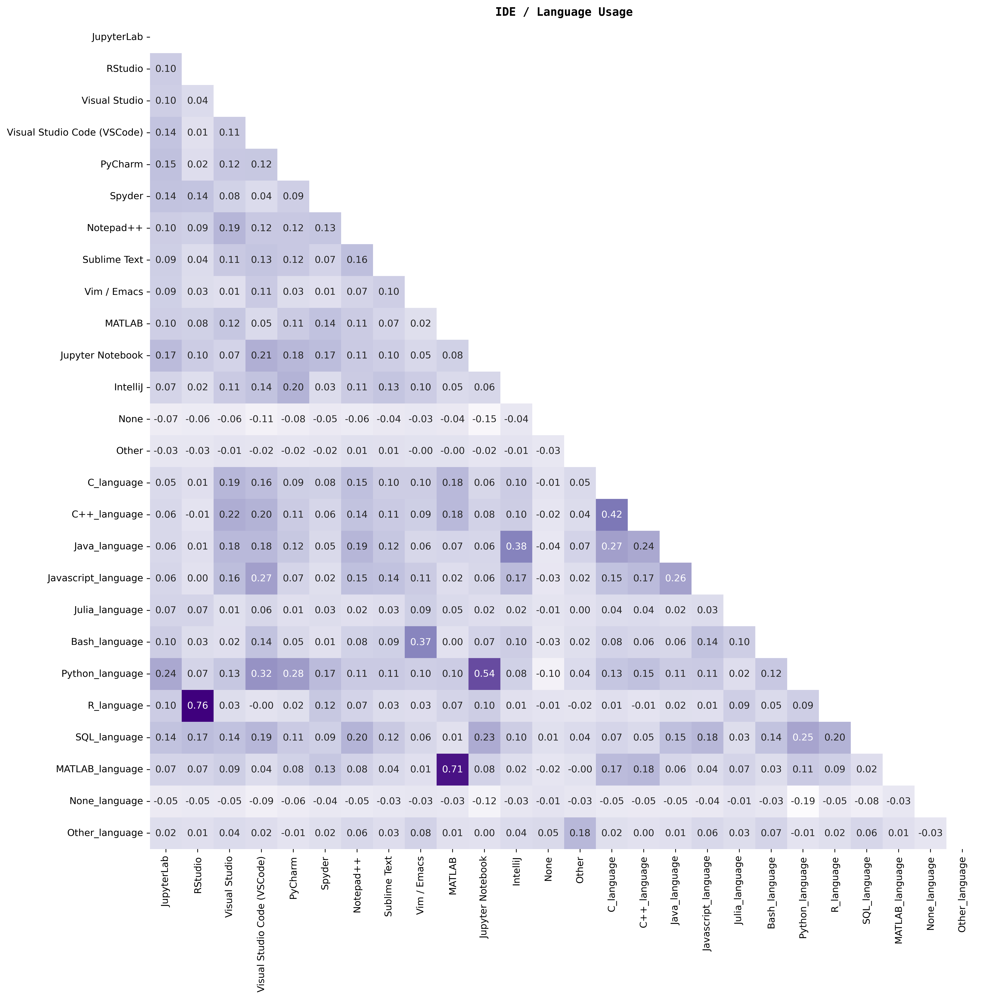

In [68]:
df4 = pd.concat([df3, df2[languages].add_suffix('_language')], axis=1)
correlation_train = df4[ide_cols+[lang+'_language'for lang in languages]].corr(method='kendall')
mask = np.triu(correlation_train.corr())
plt.figure(figsize=(16, 16))
sns.heatmap(correlation_train,
            annot=True,
            fmt='.2f',
            cmap='Purples',
            square=True,
            mask=mask,
            
            cbar=False,
            annot_kws={"fontsize":10})

plt.xlabel('')
plt.ylabel('')
plt.title("IDE / Language Usage", fontname = 'monospace', weight='bold')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

plt.show()

Most used DS Frameworks

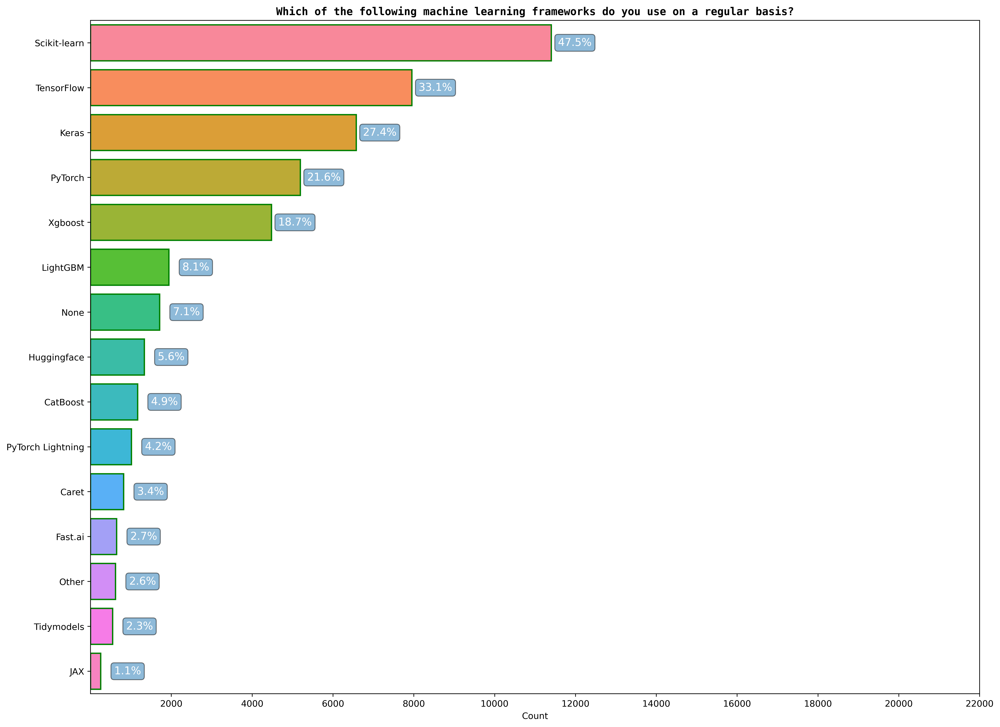

In [71]:
ml_cols = [col.split('?')[-1].strip() for col in data.columns if "machine learning frameworks" in col]
df7=one_hot_count(df=data, values=ml_cols, text="Which of the following machine learning frameworks do you use on a regular basis? ",shift_text=1000, x_freq=2000,
                 title="Which of the following machine learning frameworks do you use on a regular basis?", fontsize=12)

Percentage of participants who use libraries.

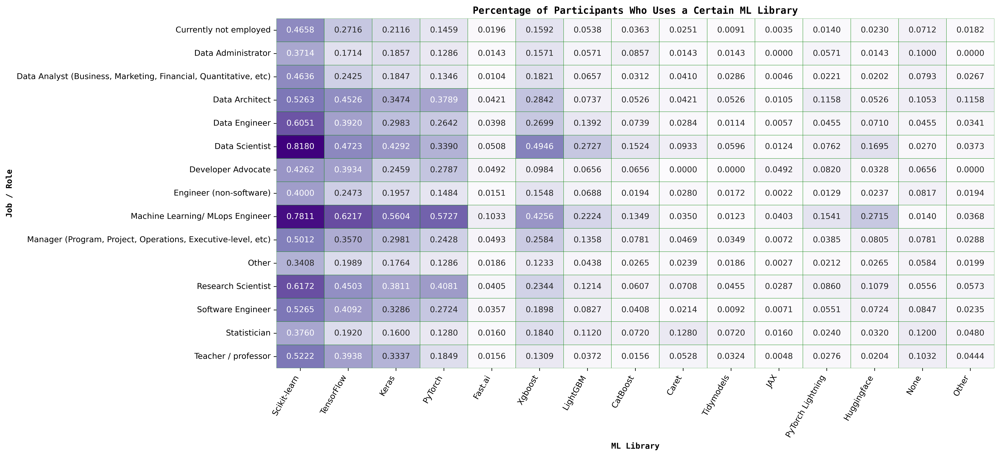

In [72]:
fig, ax = plt.subplots(figsize=(16, 8))
sns.heatmap(df7.groupby('Select the title most similar to your current role (or most recent title if retired):')[ml_cols].mean(),
            xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":10}, fmt='.4f', cbar=False)
plt.title('Percentage of Participants Who Uses a Certain ML Library', fontname = 'monospace', weight='bold')
plt.ylabel('Job / Role', fontname = 'monospace', weight='semibold')
plt.xlabel('ML Library', fontname = 'monospace', weight='semibold')
plt.xticks(rotation=60, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.show()

Regularly used ML algorithms

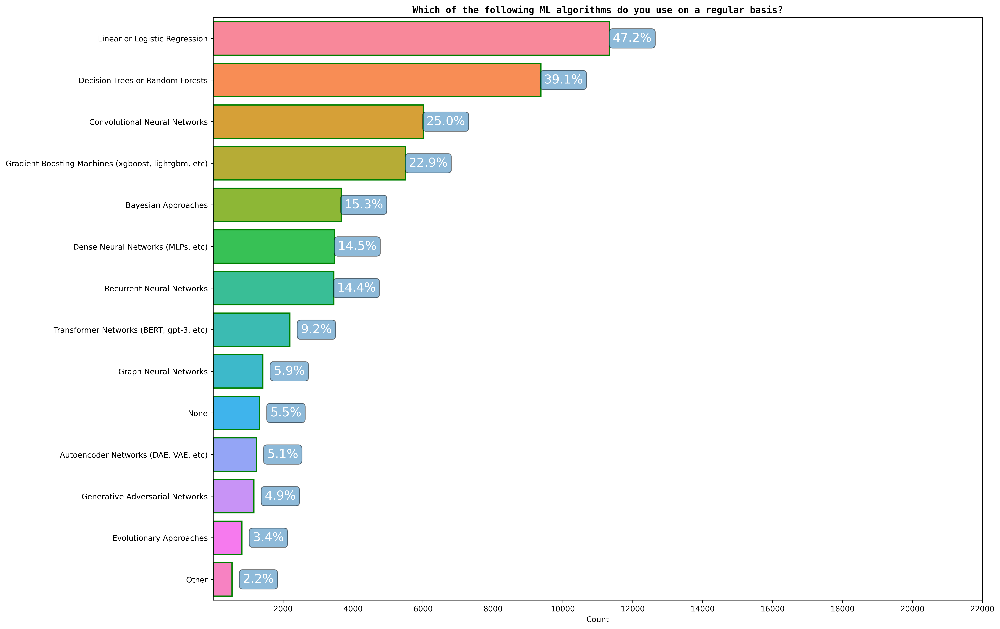

In [74]:
alg_cols = [col.split('?')[-1].strip() for col in data.columns if "ML algorithms" in col]
df8=one_hot_count(df=data, values=alg_cols, text="Which of the following ML algorithms do you use on a regular basis? ", shift_text=1200, x_freq=2000,
                 title="Which of the following ML algorithms do you use on a regular basis?", fontsize=16)

Percentage Of Participants who use certain algorithms

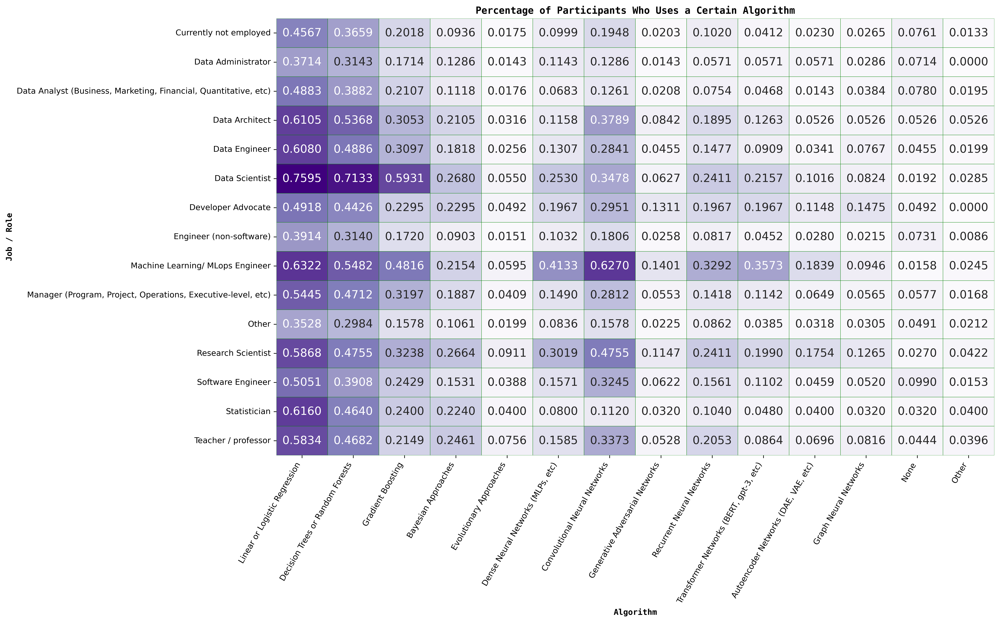

In [75]:
fig, ax = plt.subplots(figsize=(16, 10))
sns.heatmap(df8.groupby('Select the title most similar to your current role (or most recent title if retired):')[alg_cols].mean(),
            xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":14}, fmt='.4f', cbar=False)
plt.title('Percentage of Participants Who Uses a Certain Algorithm', fontname = 'monospace', weight='bold')
plt.ylabel('Job / Role', fontname = 'monospace', weight='semibold')
plt.xlabel('Algorithm', fontname = 'monospace', weight='semibold')
plt.xticks(rotation=60, ha='right', fontsize=10)
plt.yticks(fontsize=10)
labels = [item.get_text() for item in ax.get_xticklabels()]
labels[2] = 'Gradient Boosting'
ax.set_xticklabels(labels)
plt.show()

Experience and Role Distribution

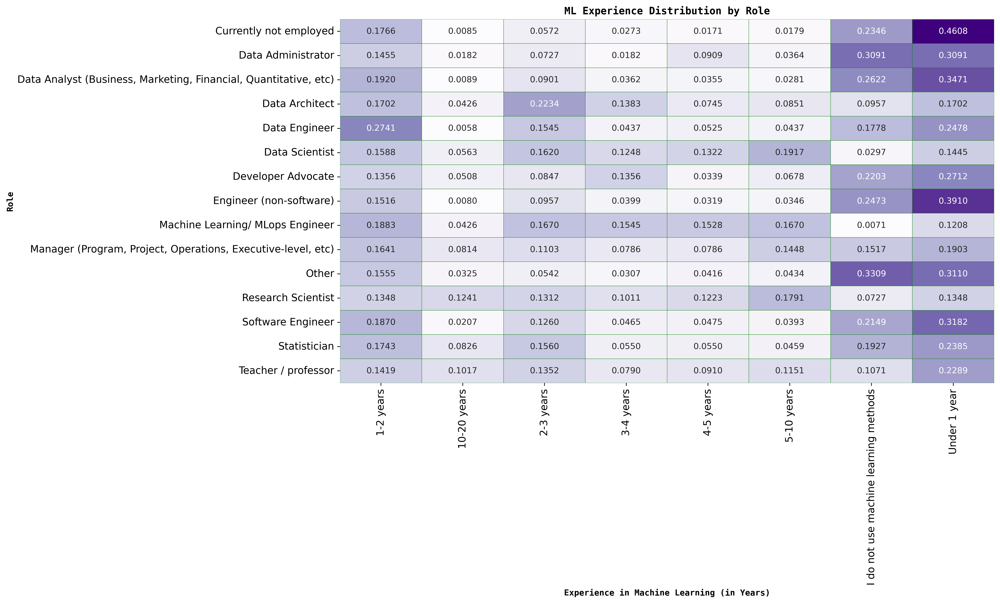

In [77]:
z=data.groupby(['Select the title most similar to your current role (or most recent title if retired):',
    'For how many years have you used machine learning methods?',
              ]).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 8))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":10}, fmt='.4f', cbar=False)
plt.title('ML Experience Distribution by Role', fontname = 'monospace', weight='bold')
plt.xticks(fontsize=12,rotation=90)
plt.yticks(fontsize=12)
plt.ylabel("Role", fontname = 'monospace', weight='semibold')
plt.xlabel("Experience in Machine Learning (in Years)", fontname = 'monospace', weight='semibold')
plt.show()
del z

Coding Experience and ML Expertise

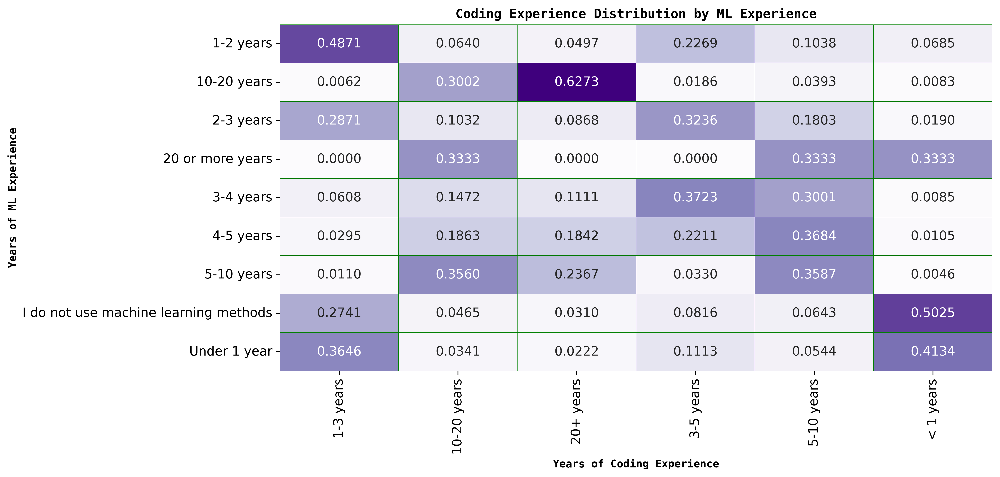

In [79]:
z=data.groupby(['For how many years have you used machine learning methods?',
    'For how many years have you been writing code and/or programming?',
    
              ]).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(12, 6))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":12}, fmt='.4f', cbar=False)
plt.title('Coding Experience Distribution by ML Experience', fontname = 'monospace', weight='bold')
plt.xticks(fontsize=12,rotation=90)
plt.yticks(fontsize=12)
plt.ylabel("Years of ML Experience", fontname = 'monospace', weight='semibold')
plt.xlabel("Years of Coding Experience", fontname = 'monospace', weight='semibold')
plt.show()
del z

Activities in each role.

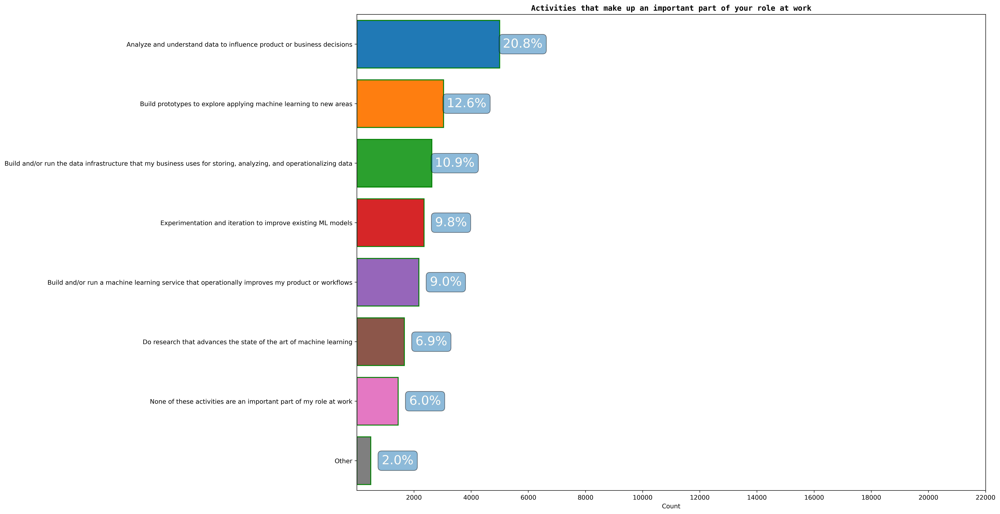

In [84]:
activities = [col.split(':')[-1].strip() for col in data.columns if "an important part" in col]
df10=one_hot_count(df=data, values=activities, text="Select any activities that make up an important part of your role at work: ", shift_text=1500, x_freq=2000,
                 title="Activities that make up an important part of your role at work", fontsize=20)

Percentage of Work by Role

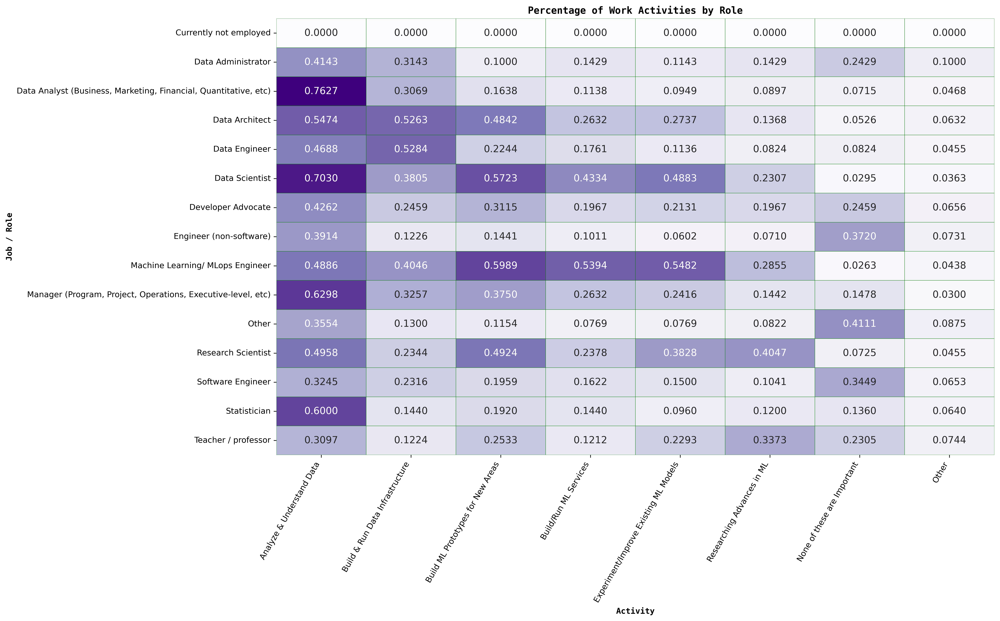

In [86]:
fig, ax = plt.subplots(figsize=(16, 10))
sns.heatmap(df10.groupby('Select the title most similar to your current role (or most recent title if retired):')[activities].mean(),
            xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":12}, fmt='.4f', cbar=False)
plt.title('Percentage of Work Activities by Role', fontname = 'monospace', weight='bold')
plt.ylabel('Job / Role', fontname = 'monospace', weight='semibold')
plt.xlabel('Activity', fontname = 'monospace', weight='semibold')
plt.xticks(rotation=60, ha='right', fontsize=10)
plt.yticks(fontsize=10)

labels = [item.get_text() for item in ax.get_xticklabels()]
labels = ['Analyze & Understand Data', ' Build & Run Data Infrastructure', ' Build ML Prototypes for New Areas', 'Build/Run ML Services', 'Experiment/Improve Existing ML Models',
         'Researching Advances in ML', 'None of these are Important', 'Other']
ax.set_xticklabels(labels)

plt.show()

Experience and Work Activity

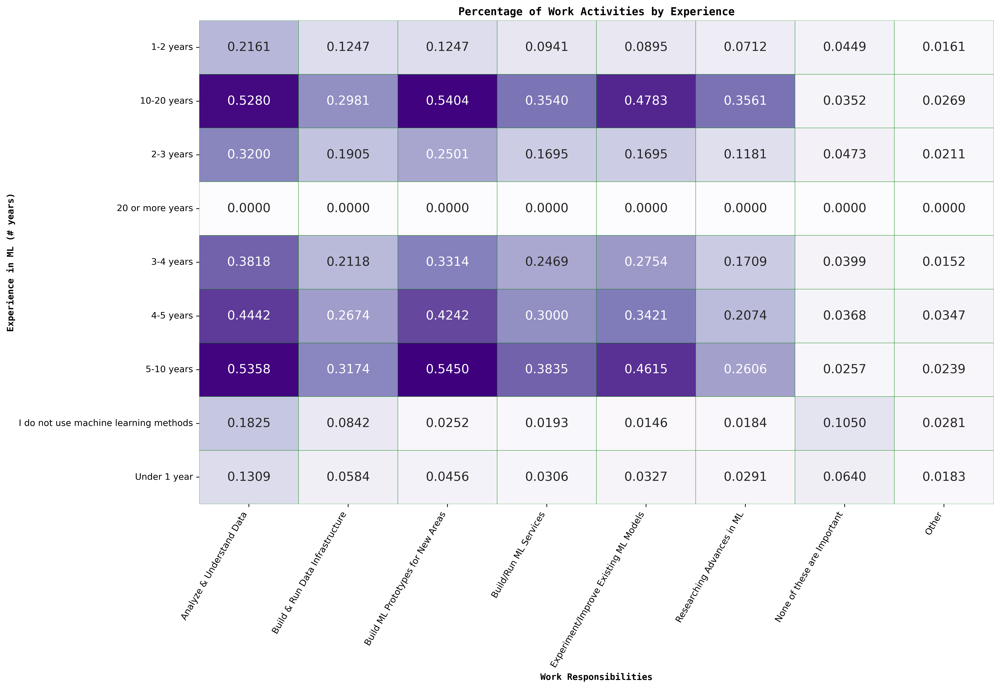

In [87]:
fig, ax = plt.subplots(figsize=(16, 10))
sns.heatmap(df10.groupby('For how many years have you used machine learning methods?')[activities].mean(),
            xticklabels=True, yticklabels=True, cmap='Purples', annot=True, linewidths=0.005, linecolor='green', annot_kws={"fontsize":14}, fmt='.4f', cbar=False)
plt.title('Percentage of Work Activities by Experience', fontname = 'monospace', weight='bold')
plt.ylabel('Experience in ML (# years)', fontname = 'monospace', weight='semibold')
plt.xlabel('Work Responsibilities', fontname = 'monospace', weight='semibold')
plt.xticks(rotation=60, ha='right', fontsize=10)
plt.yticks(fontsize=10)

labels = [item.get_text() for item in ax.get_xticklabels()]
labels = ['Analyze & Understand Data', ' Build & Run Data Infrastructure', ' Build ML Prototypes for New Areas', 'Build/Run ML Services', 'Experiment/Improve Existing ML Models',
         'Researching Advances in ML', 'None of these are Important', 'Other']
ax.set_xticklabels(labels)

plt.show()

**Insights Out of EDA**

I have left the Industry based Roles for seperate Analysis. 

**Data Science Industry in 2022**

I'm going to try to understand how AI is used in business.
